## Deepdream and Mechanistic Interpretability (or: Do image classifiers deepdream of electric sheep?)


This uses a `VGG19` Convolutional Neural Network (CNN) pretrained on the `ImageNet-1k` dataset. Images that are produced by a Deepdream algorithm are dependent on the specific model architecture and the data it was trained on. I chose `VGG19` because it has enough layers to see slight changes at each stage. Earlier versions of the model (VGG13, VGG16) quickly become overwhelmed by the dream algorithm and take over the image, which complicates the ultimate goal of using the algorithm for mechanistic interpretability.


After we visualize how the model interprets different features of an image by generating a series of increasingly bizarre deepdreams, we'll next try to zero the channels responsible for making predictions of a certain class. In this case we'll focus on container ships and cruise ships, and see if we blind the model to one kind of massive vessel, how will it perform on another.


This can inform how similar or different classes are represented in the learned parameters of the `VGG19` classifier. While this architecture is no longer cutting-edge, it is still used in resource constrained environments and is the basis for some newer image classifiers.

#### Imports

In [ ]:
from collections import Counter, defaultdict, namedtuple
import torch
from PIL import Image
import copy
import numpy as np
import transformers
from transformers import AutoImageProcessor, ResNetForImageClassification
import matplotlib.pyplot as plt
import timm
from pathlib import Path
import einops
%matplotlib inline

transformers.logging.set_verbosity_error()


#### Setup
Next we download the pretrained model and labels.

Helper functions for:
- Processing images
- Displaying images in a plot
- Classifying images

In [ ]:
processor = AutoImageProcessor.from_pretrained("microsoft/resnet-50")
resnet = ResNetForImageClassification.from_pretrained("microsoft/resnet-50")
id2label = resnet.config.id2label
if torch.backends.mps.is_available():
    device = torch.device("mps")
elif torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")
# Initialize a pretrained VGG19 model
vgg = timm.create_model("vgg19", pretrained=True)

In [ ]:
img_path = Path("/content/drive/MyDrive/deepdream/images")


def process_img(img_path: Path):
    return processor(Image.open(img_path), return_tensors="pt", do_normalize=False)["pixel_values"]


sheep = process_img(img_path / "sheep.jpg")
owl = process_img(img_path / "owl.png")
churn = process_img(img_path / "churn.jpeg")


# Many different ways to dream
dream_length = {"nap": 20, "siesta": 60, "red_eye": 110, "light": 160, "heavy": 210, "deep": 250}

In [ ]:
def tensor_to_image(tensor: torch.Tensor):
    tensor = tensor.squeeze()
    tensor = tensor.permute(1, 2, 0)
    tensor = tensor.detach().cpu().numpy()
    tensor = (tensor * 255).astype(np.uint8)
    return tensor


def plot_images(images, figsize=None, num_cols=None, hspace=0.1):
    num_images = len(images)

    cols = num_cols or min(num_images, 6)
    rows = (num_images + cols - 1) // cols
    figsize = figsize or (cols * 4, rows * 4)

    # Sets black background
    fig, axs = plt.subplots(rows, cols, figsize=figsize, facecolor="black")
    fig.subplots_adjust(
        hspace=hspace,
        wspace=0.1,
    )
    axs = np.atleast_2d(axs)

    for i, (label, img) in enumerate(images.items()):
        img = tensor_to_image(img)
        row = i // cols
        col = i % cols
        ax = axs[row, col]

        ax.imshow(img)
        ax.set_title(label, color="white")
        ax.axis("off")

    # Remove any unused subplots
    if num_images < (rows * cols):
        for j in range(num_images, rows * cols):
            row = j // cols
            col = j % cols
            axs[row, col].axis("off")

    plt.rcParams["figure.facecolor"] = "black"
    plt.rcParams["axes.facecolor"] = "black"
    plt.rcParams["text.color"] = "white"

    plt.show()


@torch.no_grad()
def classify(image, model):
    logits = model.to(device)(image.to(device))
    label = id2label[logits.argmax(dim=-1).item()]
    conf = logits.softmax(dim=-1).max().item()
    return label, conf

First we need to hook into the model so we can capture the activation outputs from each module. We will use these later to analyze what layers and channels are used to make predictions.

In [ ]:
# Initialize the dictionary to record layer outputs
layer_outputs = {}


def reg_hook(layer, layer_idx):
    def hook_fn(module, input, output):
        layer_outputs[layer_idx] = output

    layer.register_forward_hook(hook_fn)


def get_hooked_model(model):
    model = copy.deepcopy(model).to(device)
    for idx, layer in enumerate(model.features):
        if (
            isinstance(layer, torch.nn.Conv2d)
            or isinstance(layer, torch.nn.ReLU)
            or isinstance(layer, torch.nn.MaxPool2d)
        ):
            reg_hook(layer, idx)
    return model

Initialize the hooked model

In [ ]:
hooked = get_hooked_model(vgg)

#### How machine learning models "dream"

The Gram Matrix loss is an alternative to the l2 norm that aims to preserve the stylistic texture of the input image.  It is typically used in [style transfer applications](https://arxiv.org/pdf/1508.06576), like taking a photograph of a dog and generating a new image of it in the style of a Picasso painting. In this context the goal is to use a Gram matrix loss to make the dream images maintain the style of the input image.


In [ ]:
def gram_matrix(img):
    features = einops.rearrange(img, "batch channel height width -> batch channel (height width)")
    gram = torch.matmul(features, einops.rearrange(features, "batch channel hw -> batch hw channel"))
    return gram.sum()

This is one implementation of the deepdream algorithm. It uses gradient *ascent* to update the input image. While you would typically zero the gradients with `model.zero_grad()` before performing backward propagation, I found this produced images that were too quickly overwhelmed by the dream elements, making the task of mechanistic interpretability more difficult.

In [ ]:
def dream(
    input_image,
    model=hooked,
    layer_outputs=layer_outputs,
    layer=35,
    channel=None,
    learning_rate=0.01,
    epochs=30,
    loss_fn=None,
    loss_weight=1e-5,
):
    """
    Performs a simple deepdream visualization on an image using a pre-trained PyTorch model.

    Args:
        input_image: A PyTorch tensor representing the image to be processed.
        model: A pre-trained PyTorch model.
        layer_outputs: A dictionary to record feature outputs of the model.
        layer: The index of the layer in the model to use for dream generation.
        channel: The specific channel within the feature map to focus on (optional).
        learning_rate: The learning rate for gradient ascent (defaults to 0.01).
        epochs: The number of iterations for the optimization process (defaults to 30).
        loss_fn: Loss function to use (defaults to l2).
        loss_weight: A weigh applied when the loss_fn is Gram matrix (defaults to 1e-5).

    Returns:
        A PyTorch tensor representing the deep dream visualization of the input image.
    """
    input_image = copy.deepcopy(input_image.detach())
    dream = input_image.to(device).requires_grad_()
    model = model.to(device)
    for _ in range(epochs):
        model(dream)
        if loss_fn is None:
            if channel is None:
                loss = torch.linalg.vector_norm(layer_outputs[layer])
            else:
                loss = torch.linalg.vector_norm(layer_outputs[layer][:, channel, :, :])

        else:
            if channel is None:
                loss = loss_weight * loss_fn(layer_outputs[layer])
            else:
                loss = loss_weight * loss_fn(layer_outputs[layer][:, channel, :, :])

        # model.zero_grad()
        dream.grad = None
        loss.backward()
        dream.data += learning_rate * dream.grad
        dream.data = torch.clamp(dream.data, 0, 1)

    return dream

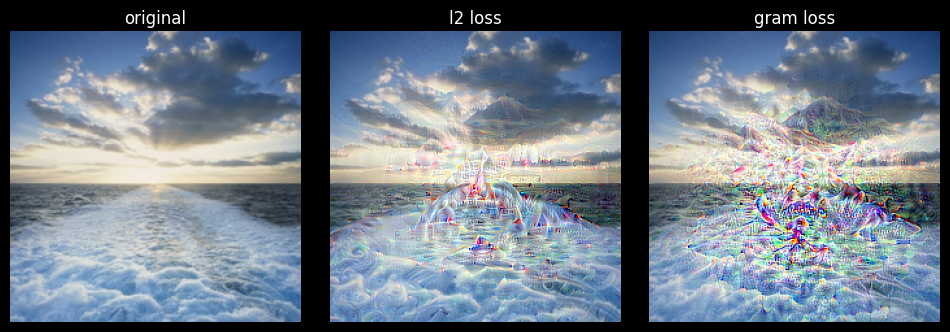

In [ ]:
plot_images(
    {"original": churn, "l2 loss": dream(churn, epochs=35), "gram loss": dream(churn, epochs=35, loss_fn=gram_matrix)}
)

The more epochs the model is run, the more the dream elements take over the original image. The Gram matrix loss also consumes the image faster since it returns a sum multiplied by a loss weight instead of a norm.

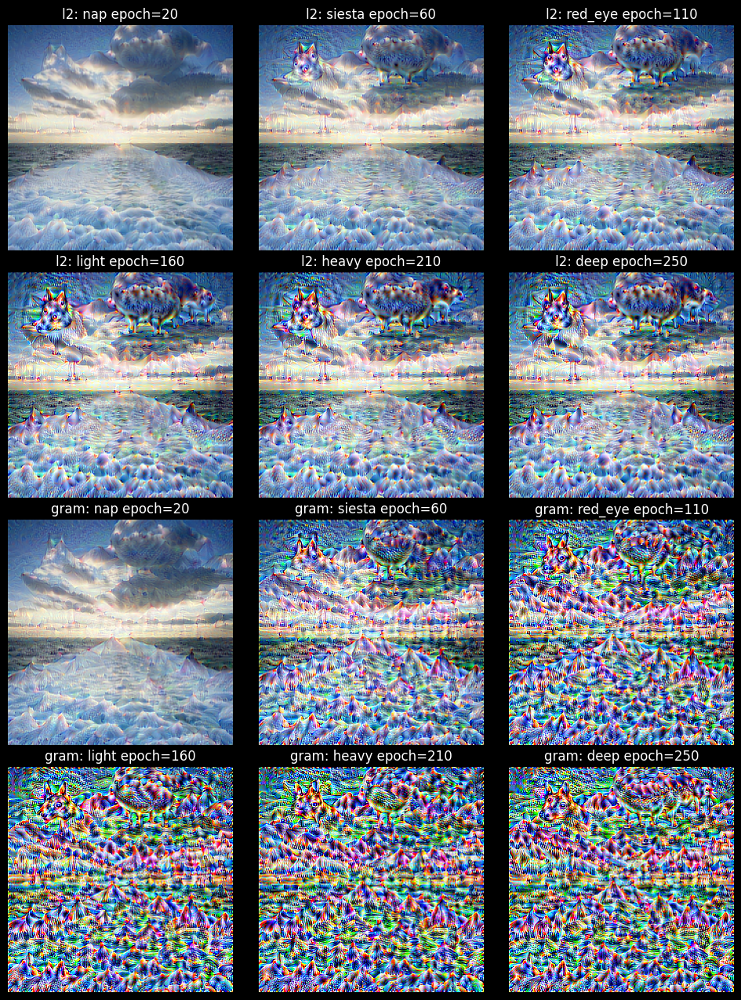

In [ ]:
out = {}
for sleep, epoch in dream_length.items():
    out[f"l2: {sleep} {epoch=}"] = dream(churn, layer=29, epochs=epoch)

for sleep, epoch in dream_length.items():
    out[f"gram: {sleep} {epoch=}"] = dream(churn, layer=29, epochs=epoch, loss_fn=gram_matrix)

plot_images(out, num_cols=3)

Now let's look at what aspects the model is picking up on in each layer. Here we can see the layers that are picking up on the repetitive patterns in the waves and which are generating animal shapes in the clouds. This is the first step in developing an understanding of what parts of the model do what.

Again we can see the images produced with Gram matrix loss are almost entirely consumed and in some layers there's no trace of the source material. Interestingly though, by the end of the network these chaotic scenes entirely fade away.

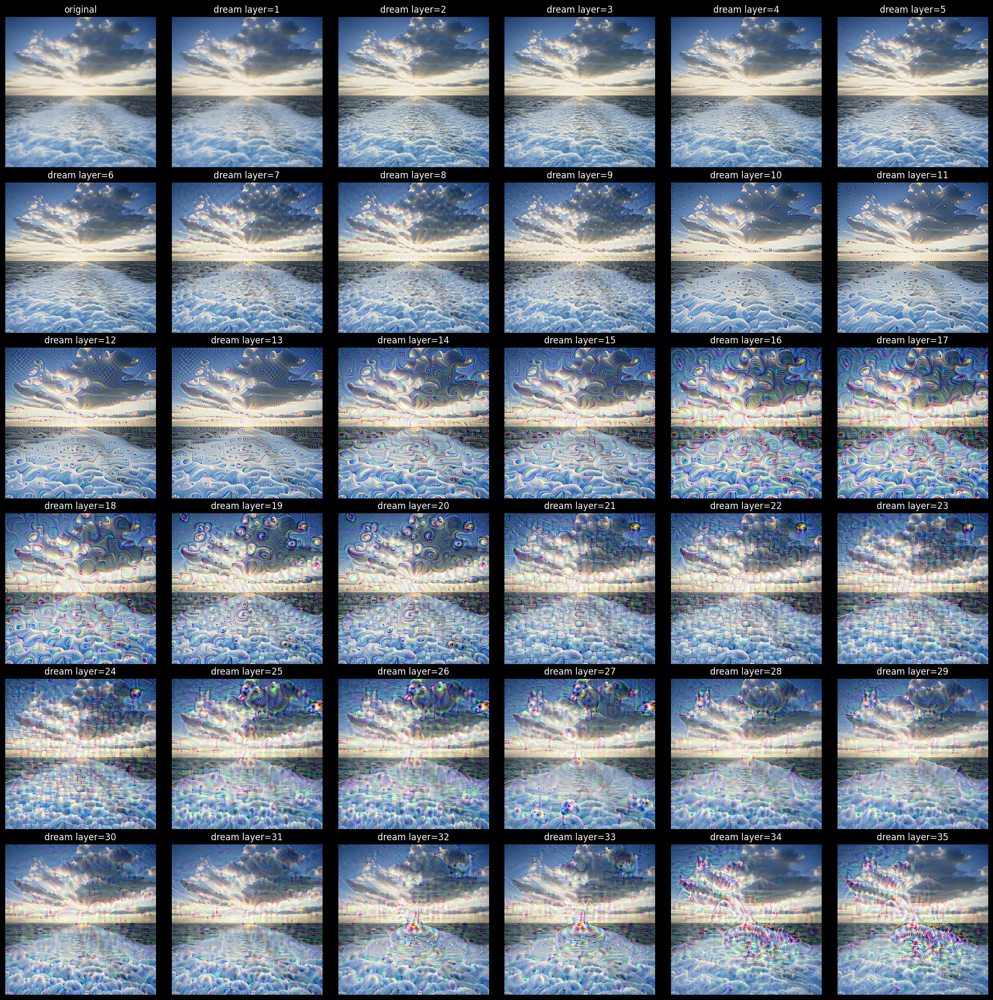

In [ ]:
input = churn
result = {"original": input}
for layer in range(1, 36):
    result[f"dream {layer=}"] = dream(input, layer=layer, learning_rate=0.02, epochs=30).to(device)
plot_images(result)

In [ ]:
input = churn
result = {"original": input}
for layer in range(1, 36):
    result[f"dream {layer=}"] = dream(input, layer=layer, loss_fn=gram_matrix).to(device)
plot_images(result)

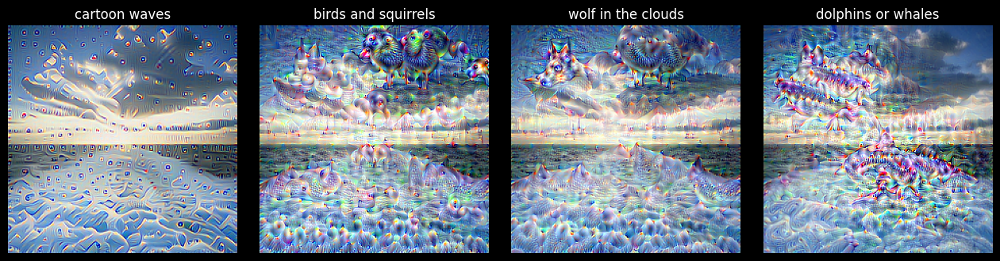

In [ ]:
plot_images(
    {
        "cartoon waves \n layer 11": dream(churn, learning_rate=0.02, layer=11, epochs=50),
        "birds and squirrels \n layer 26": dream(churn, learning_rate=0.02, layer=26, epochs=50),
        "wolf in the clouds \n layer 29": dream(churn, learning_rate=0.02, layer=29, epochs=50),
        "dolphins or whales \n layer 35": dream(churn, learning_rate=0.02, layer=35, epochs=50),
    }
)

#### Dreaming of Sheep and Owls


The dataset used to train `VGG19` contains a lot of animals, so it makes sense that faces or heads of animals manifest in images passed to the dream algorithm. But let's see what patterns emerge when it's fed images of animals.


Eyes seem particularly important, and in both the sheep and owl they feature prominently. For the owl, its glowing red eye takes on a human quality to me. Eerie indeed.

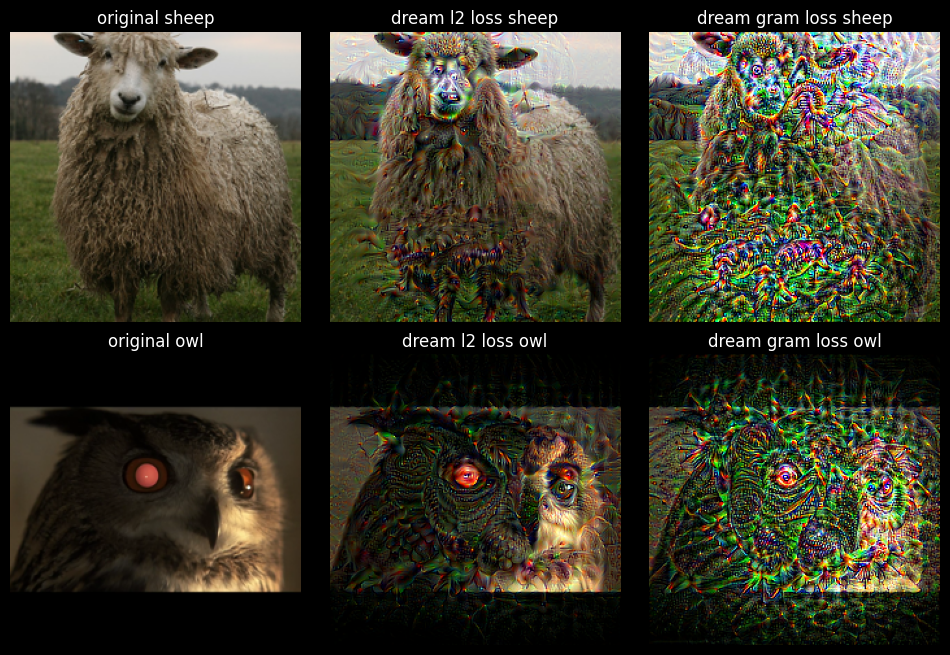

In [ ]:
electric_animals = {}
epochs = 50

electric_animals[f"original sheep"] = sheep
electric_animals[f"dream l2 loss sheep"] = dream(sheep, epochs=epochs)
electric_animals[f"dream gram loss sheep"] = dream(sheep, loss_fn=gram_matrix, epochs=epochs)
electric_animals[f"original owl"] = owl
electric_animals[f"dream l2 loss owl"] = dream(owl, epochs=epochs)
electric_animals[f"dream gram loss owl"] = dream(owl, loss_fn=gram_matrix, epochs=epochs)

plot_images(electric_animals, num_cols=3)

In [ ]:
out = {}
for sleep, epochs in dream_length.items():
    out[f"l2: {sleep} {epochs=}"] = dream(owl, epochs=epochs)

for sleep, epochs in dream_length.items():
    out[f"gram: {sleep} {epochs=}"] = dream(owl, epochs=epochs, loss_fn=gram_matrix)

plot_images(out, num_cols=3)

### Mechanistic Interpretability


#### Pinpointing activations




Now we'll isolate parts of the model that are associated with identifying specific elements of an image and try to see what elements are most important.




For this task we'll look at container ships and cruise ships. These images contain a mix of natural elements (water, sky, coastline) and aspects of the built environment (sharp straight lines of the hull, repeated boxy patterns of windows or containers).


In these initial dream images we can already see how the model is generating patterns that evoke the waters surrounding the vessels in container ships 1, 4 and 5 as well as cruise ship 3 and 5.



In [ ]:
container_ships = []
cruise_ships = []
for ship in (img_path / "ships").iterdir():
    if "container" in ship.name:
        container_ships.append(process_img(ship))
    else:
        cruise_ships.append(process_img(ship))

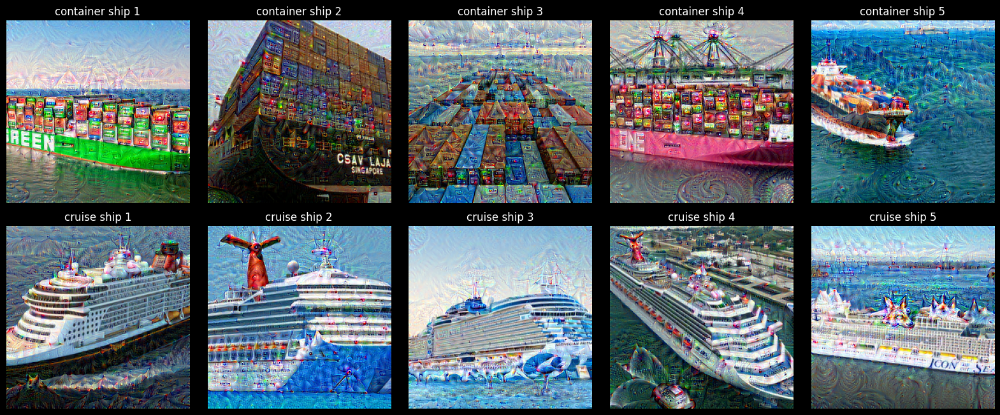

In [ ]:
out = {}
for i, ship in enumerate(container_ships):
    out[f"container ship {i+1}"] = dream(ship, layer=29, loss_fn=gram_matrix, epochs=30)
for i, ship in enumerate(cruise_ships):
    out[f"cruise ship {i+1}"] = dream(ship, layer=29, loss_fn=gram_matrix, epochs=30)

plot_images(out, num_cols=5)

Now let's get some more granular detail and see what's happening at a lower level.

1.   `export_activations` passes an image through the model and captures the activations at each layer. It then computes the mean activation across the batch dimension for each channel in each layer and returns them in a dictionary.
2.   `top_activations` finds the top k activations for each layer and stores them in a list. Optionally filters activations below a certain threshold.
3. `count_activations` counts how many times each activation index appears across different instances. It provides insights into which activations are most commonly triggered across the dataset.

Together, these functions provide a way to extract, filter, and analyze the most prominent activations within our neural network, which is crucial for understanding what features the network is focusing on during inference.


In [ ]:
def export_activations(input, model=hooked, layer_outputs=layer_outputs):
    input_image = input.to(device).requires_grad_()
    model = model.to(device)
    model(dream)
    activations = {
        idx: einops.reduce(output.detach().clone(), "batch channel height width -> channel", "mean")
        for idx, output in layer_output.items()
    }
    return activations


def top_activations(activations, k=10, threshold=0):
    out = {}
    for idx, activation in activations.items():
        values, i = torch.topk(activation, k, largest=True, sorted=True)
        out[idx] = i[values > threshold].tolist()
    return out


def count_activations(top_activations):
    counts = defaultdict(Counter)
    for activation in top_activations:
        for layer, channel in activation.items():
            counts[layer].update(channel)
    return counts

In [ ]:
container_activations = [export_activations(ship) for ship in container_ships]
container_top_activations = [top_activations(activations) for activations in container_activations]
container_channel_counts = count_activations(container_top_activations)

cruise_activations = [export_activations(ship) for ship in cruise_ships]
cruise_top_activations = [top_activations(activations) for activations in cruise_activations]
cruise_channel_counts = count_activations(cruise_top_activations)

Here we visualize the top activations in the later layers of the network, where things get more interesting.

When the model is passed a container ship, the repetitive boxy patterns manifest in earlier layers. Later on we see other layers picking up on the water around the ships. This makes intuitive sense and in many ways is also how a human would decide if a vessel is a container ship or something else.

Similarly with cruise ships, the model seems to again focus on water, but also relies on the silhouette of the vessel, particularly the peaks formed by antennae and smoke stacks.

In [ ]:
def plot_activation_counts(counts, imgs, min_layer=20, top_common=5, threshold=4):
    for layer, count in counts.items():
        # Interesting things happen further along in the network
        if layer < min_layer:
            continue
        for channel, channel_count in count.most_common(top_common):
            if channel_count < threshold:
                continue
            dreams = {}
            for i, img in enumerate(imgs):
                dreams[f"{i+1}: {layer=} {channel=}\n{channel_count=}"] = dream(
                    img, layer=layer, channel=channel, learning_rate=0.05, epochs=20
                )
            plot_images(dreams)


plot_activation_counts(container_channel_counts, container_ships)

In [ ]:
plot_activation_counts(cruise_channel_counts, cruise_ships)

In [ ]:
comparison = {}
for key in range(37):
    comparison[key] = len(set(container_channel_counts[key].keys()) & set(cruise_channel_counts[key].keys()))
sum(comparison.values()) / 36

14.055555555555555

#### Blinding the model


What if the image classifier no longer knew how to recognize a container or cruise ship? If we focus on the activations that were most associated with a container vessel and zero them out or inject random noise, we can blind the model so it makes incorrect predictions. We pass the same activations that were used to visualize the crucial elements above to blind_model and see how it performs before and after.


I also present several options for blinding the model. `zero_channel` and `noise_channel` have largely the same effect, where those channels no longer contain information from training. However, `inject_noise` adds random noise to the learned parameters and is less effective at blinding the model, although it does tend to reduce confidence scores.

In [ ]:
Channel = namedtuple("Channel", ["layer", "channel"])


def zero_channel(layer, channel):
    def hook_fn(module, input, output):
        output[:, channel, :, :] = 0.0

    layer.register_forward_hook(hook_fn)


def noise_channel(layer, channel, noise_factor=0.1):
    def hook_fn(module, input, output):
        noise = torch.randn_like(output[:, channel, :, :]) * noise_factor
        output[:, channel, :, :] = noise

    layer.register_forward_hook(hook_fn)


def inject_noise(layer, channel, noise_factor=0.1):
    def hook_fn(module, input, output):
        noise = torch.randn_like(output[:, channel, :, :]) * noise_factor
        output[:, channel, :, :] += noise

    layer.register_forward_hook(hook_fn)


def blind_model(model, channel_counts, start_layer=20, top=4, blind_method=zero_channel, noise_factor=0.1):
    model = copy.deepcopy(model).to(device)
    for layer, layer_count in channel_counts.items():
        if layer < start_layer:
            continue
        channels_to_blind = [Channel(layer, channel) for channel, freq in layer_count.most_common(top)]

        for c in channels_to_blind:
            blind_method(model.features[c.layer], c.channel)

    return model


container_blind = blind_model(vgg, container_channel_counts)
cruise_blind = blind_model(vgg, cruise_channel_counts)

In [ ]:
control_imgs = []
for img in (img_path / "controls").iterdir():
    control_imgs.append(process_img(img))

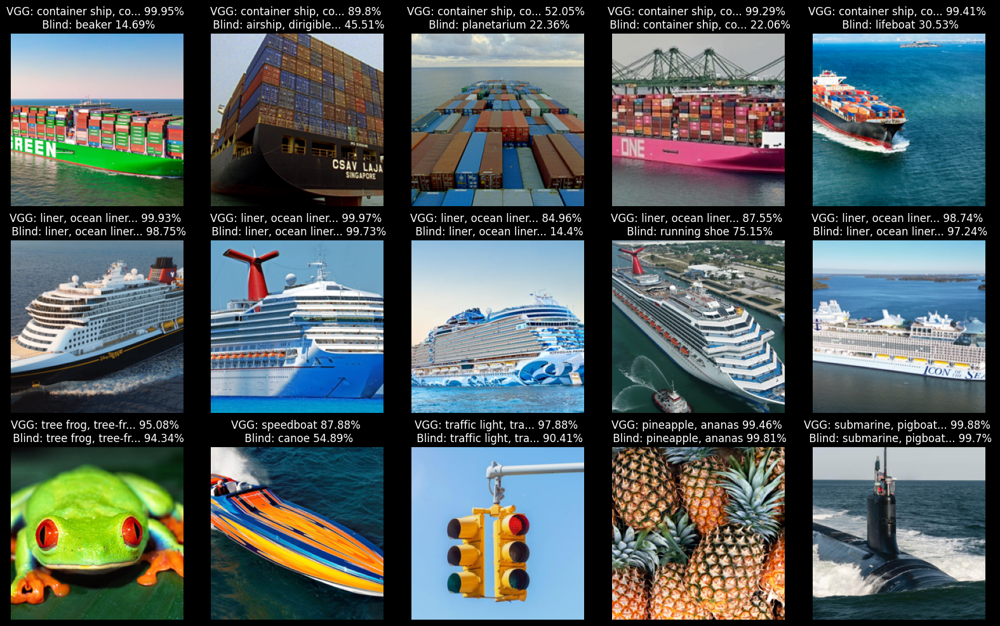

In [ ]:
def test_plot(models):
    out = {}
    img_sets = [container_ships, cruise_ships, control_imgs]

    for s in img_sets:
        for img in s:
            result = []
            for m in models:
                label, conf = classify(img, m)
                if len(label) > 17:
                    label = label[:18] + "..."
                conf = round(conf * 100, 2)
                result.append((label, conf))

            out[f"VGG: {result[0][0]} {result[0][1]}% \n Blind: {result[1][0]} {result[1][1]}%"] = img

    return out


models = (vgg, container_blind)
plot_images(test_plot(models), num_cols=5, hspace=0.2)

After blinding it can no longer correctly predict container ships. It manages in once case but the confidence drops markedly and to a level that would typically be below an acceptable threshold. The model can largely still identify “ocean liners” except in one case, showing that there are not enough shared activations between the two classes so that blinding the model to one class cripples it for the other.

The model also still mostly classifies the control images correctly. Interestingly, while it fails to classify the speedboat image, it still knows it's some type of water vessel.


The reverse holds true for cruise ships, where it fails to correctly identify any of the images. It also makes the same incorrect prediction for the control image of a speed boat.

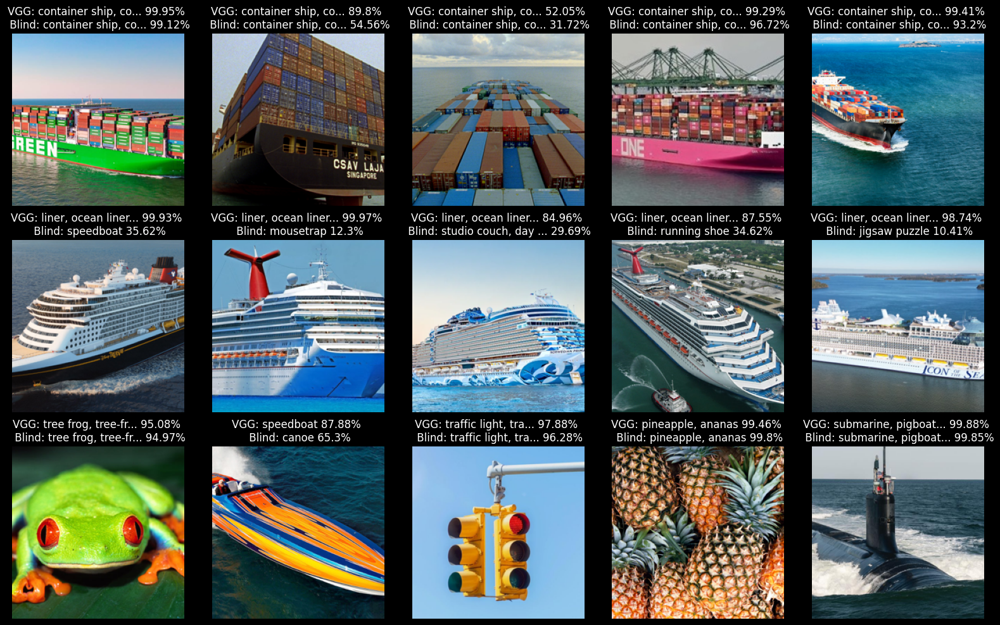

In [ ]:
models = (vgg, cruise_blind)

plot_images(test_plot(models), num_cols=5, hspace=0.2)